# Experiment 1 - YOLOv8 small (default parameters)

## 1. Setup

In [1]:
import os

In [1]:
%pip install ultralytics

import ultralytics
from ultralytics import YOLO

ultralytics.checks()

Ultralytics YOLOv8.0.114 🚀 Python-3.9.16 torch-1.12.1+cu116 CUDA:0 (NVIDIA RTX A4000, 16117MiB)
Setup complete ✅ (8 CPUs, 44.1 GB RAM, 91.8/246.0 GB disk)


In [3]:
!nvidia-smi

Tue May 30 14:16:55 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA RTX A4000    Off  | 00000000:00:05.0 Off |                  Off |
| 41%   31C    P8    12W / 140W |      2MiB / 16376MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## 2. Dataset Info

In [15]:
dataset_path = "/notebooks/maskon_dataset"
dirs = ['train', 'test', 'valid']
subdirs = ['images', 'labels']

In [6]:
for d in dirs:
    for s in subdirs:
        subdir_path = os.path.join(dataset_path, d, s)
        file_count = len(os.listdir(subdir_path))
        print(f'{d}/{s} file count: {file_count}')

train/images file count: 25320
train/labels file count: 25320
test/images file count: 3165
test/labels file count: 3165
valid/images file count: 3165
valid/labels file count: 3165


In [1]:
!wandb disabled

W&B disabled.


## 3. Train YOLOv8 small

In [8]:
!yolo task=detect mode=train model=yolov8s.pt data={dataset_path}/data.yaml epochs=60 imgsz=640 plots=True

Ultralytics YOLOv8.0.107 🚀 Python-3.9.16 torch-1.12.1+cu116 CUDA:0 (NVIDIA RTX A4000, 16117MiB)
WARNING ⚠️ Upgrade to torch>=2.0.0 for deterministic training.
yolo/engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/notebooks/maskon_dataset/data.yaml, epochs=60, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=0, resume=False, amp=True, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscrip

This `train` command will train the custom mask usage dataset and a `.pt` model will then be saved.

----

### 3.1 Training Results

In [2]:
RES_PATH = "/notebooks/small/runs/detect/train3"

In [3]:
from IPython.display import display, Image

In [5]:
!ls {RES_PATH}

F1_curve.png					 train_batch0.jpg
PR_curve.png					 train_batch1.jpg
P_curve.png					 train_batch2.jpg
R_curve.png					 val_batch0_labels.jpg
args.yaml					 val_batch0_pred.jpg
confusion_matrix.png				 val_batch1_labels.jpg
confusion_matrix_normalized.png			 val_batch1_pred.jpg
events.out.tfevents.1684905879.n2m62vebhw.362.0  val_batch2_labels.jpg
results.csv					 val_batch2_pred.jpg
results.png					 weights


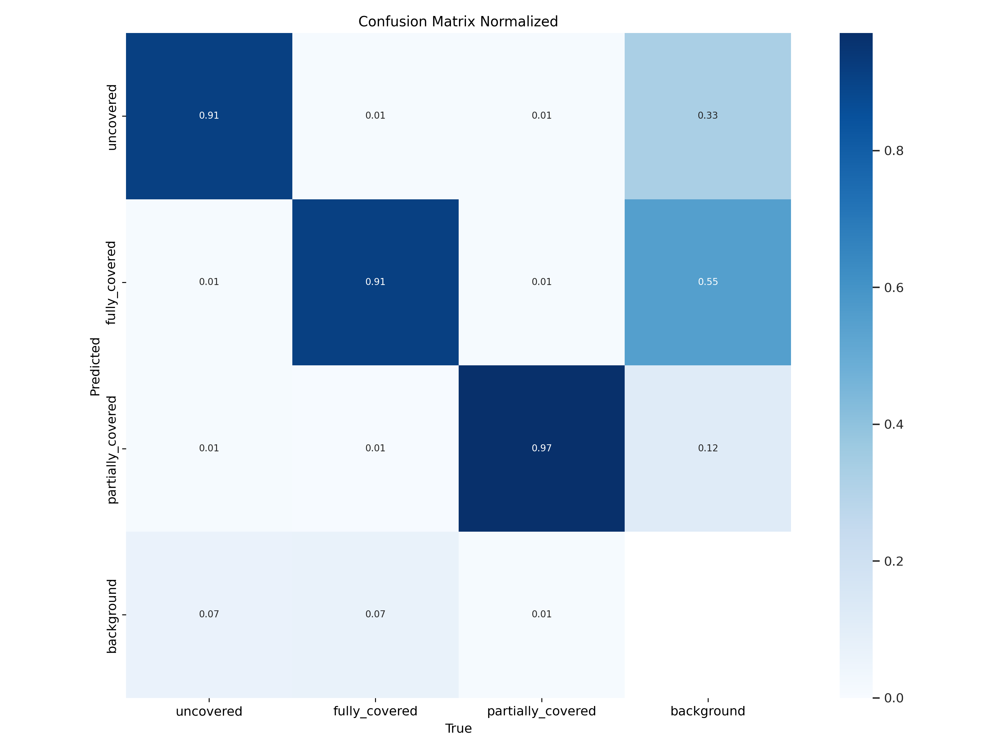

In [6]:
Image(filename=f'{RES_PATH}/confusion_matrix_normalized.png', width=640)

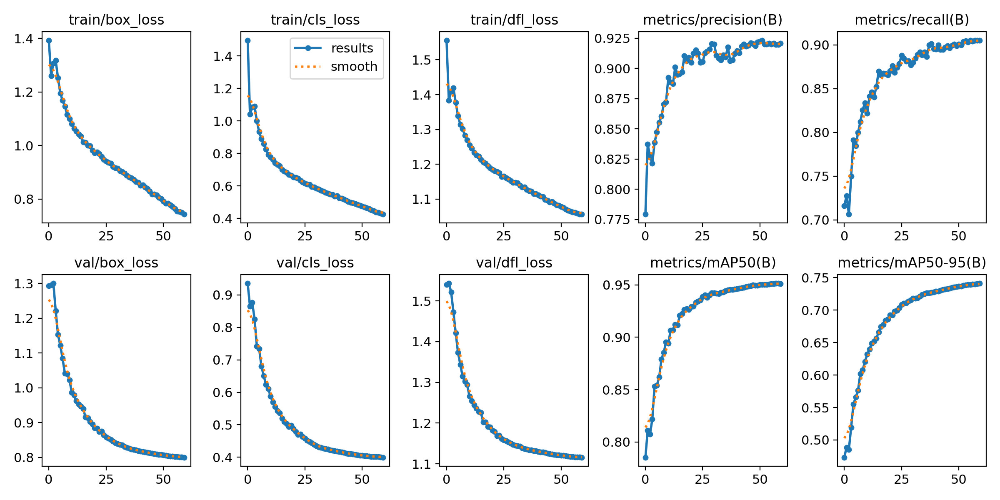

In [7]:
Image(filename=f'{RES_PATH}/results.png', width=600)

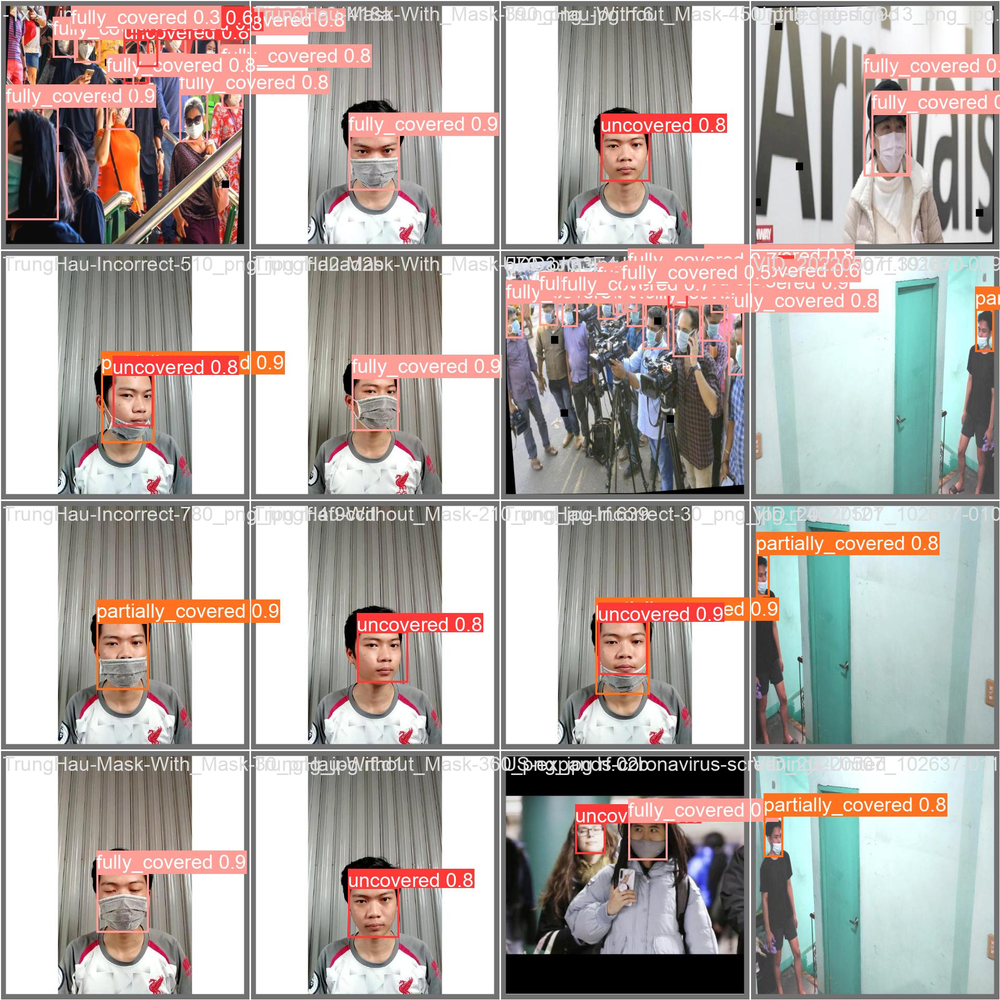

In [10]:
Image(filename=f'{RES_PATH}/val_batch0_pred.jpg', width=700)

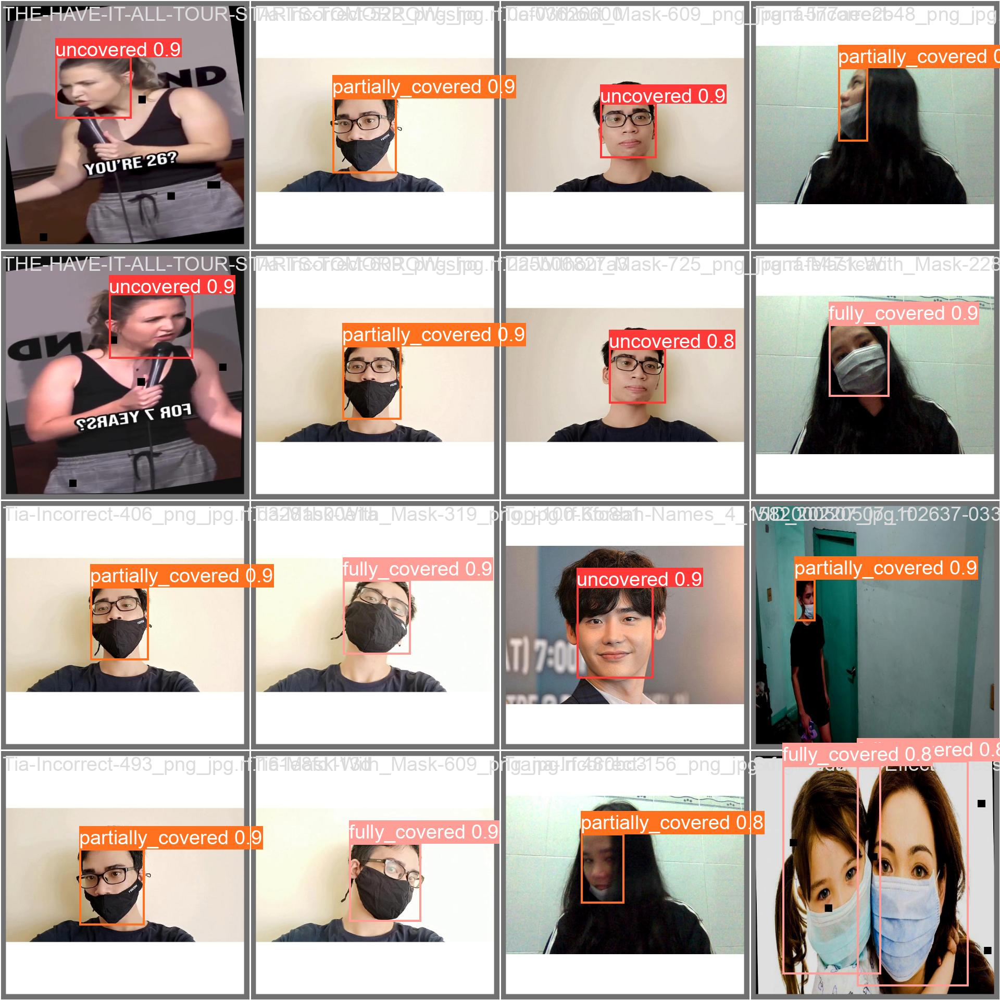

In [11]:
Image(filename=f'{RES_PATH}/val_batch1_pred.jpg', width=700)

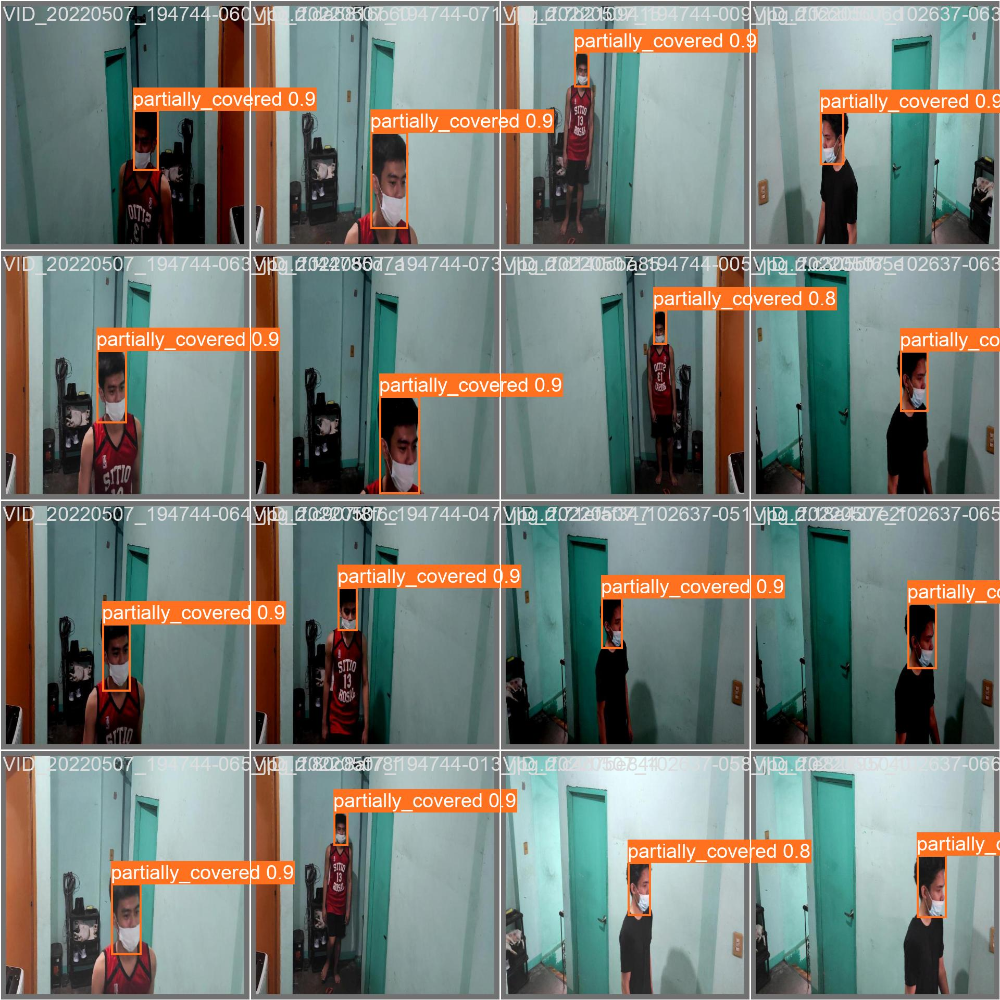

In [12]:
Image(filename=f'{RES_PATH}/val_batch2_pred.jpg', width=700)

-------

## 4. Validate Custom Model

In [16]:
!yolo task=detect mode=val model={RES_PATH}/weights/best.pt data={dataset_path}/data.yaml

Ultralytics YOLOv8.0.113 🚀 Python-3.9.16 torch-1.12.1+cu116 CUDA:0 (NVIDIA RTX A4000, 16117MiB)
Model summary (fused): 168 layers, 11126745 parameters, 0 gradients
100%|█████████████████████████████████████████| 755k/755k [00:00<00:00, 171MB/s]
val: Scanning /notebooks/maskon_dataset/valid/labels.cache... 3165 images, 12 ba
val: WARNING ⚠️ /notebooks/maskon_dataset/valid/images/1940j_jpg.rf.1ddfe910dc43946930b6b872bbe2f457.jpg: 1 duplicate labels removed
                 Class     Images  Instances      Box(P          R      mAP50  m
                   all       3165       5245      0.921      0.906      0.952      0.741
             uncovered       3165       1579      0.917      0.885      0.938       0.72
         fully_covered       3165       1666      0.873       0.87      0.929      0.664
     partially_covered       3165       2000      0.972      0.963      0.988       0.84
Speed: 0.2ms preprocess, 3.9ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs/

### 4.1 Test the custom model

In [17]:
!yolo task=detect mode=predict model={RES_PATH}/weights/best.pt conf=0.5 source={dataset_path}/test/images save=True

Ultralytics YOLOv8.0.113 🚀 Python-3.9.16 torch-1.12.1+cu116 CUDA:0 (NVIDIA RTX A4000, 16117MiB)
Model summary (fused): 168 layers, 11126745 parameters, 0 gradients

image 1/3165 /notebooks/maskon_dataset/test/images/-1x-1_jpg.rf.a45473a343abb657cefa66adb8db92cf.jpg: 640x640 3 uncovereds, 9 fully_covereds, 6.7ms
image 2/3165 /notebooks/maskon_dataset/test/images/-I1-MS09uaqsLdGTFkgnS0Rcg1mmPyAj95ySg_eckoM_jpeg_jpg.rf.e689c0294bb6c6a98e565a4f7070d585.jpg: 640x640 2 fully_covereds, 6.9ms
image 3/3165 /notebooks/maskon_dataset/test/images/00003_Mask_Mouth_Chin_jpg.rf.48358e842329c6247a16b2de18a8ded9.jpg: 640x640 1 partially_covered, 7.4ms
image 4/3165 /notebooks/maskon_dataset/test/images/00004_Mask_Mouth_Chin_jpg.rf.be3ee8dcc8f3fae4cf38aedbe77f3ea2.jpg: 640x640 1 partially_covered, 6.8ms
image 5/3165 /notebooks/maskon_dataset/test/images/00007_Mask_Mouth_Chin_jpg.rf.6ead5a7442b10e7c25275cd135e3d986.jpg: 640x640 1 partially_covered, 7.1ms
image 6/3165 /notebooks/maskon_dataset/test/images/

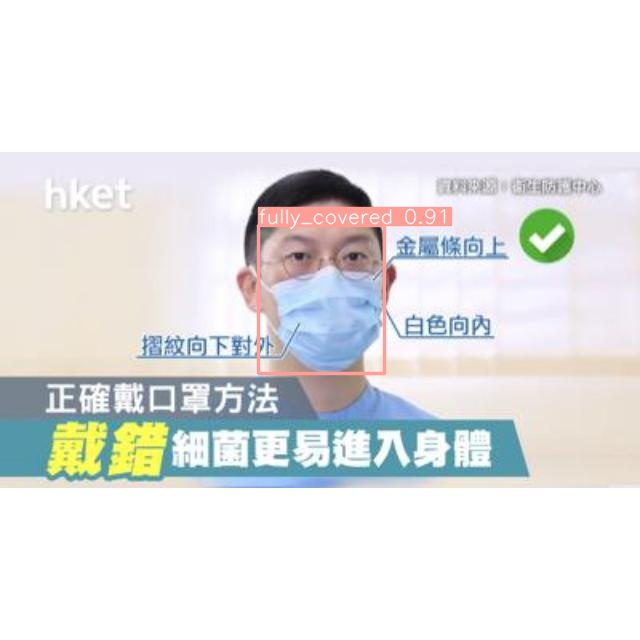

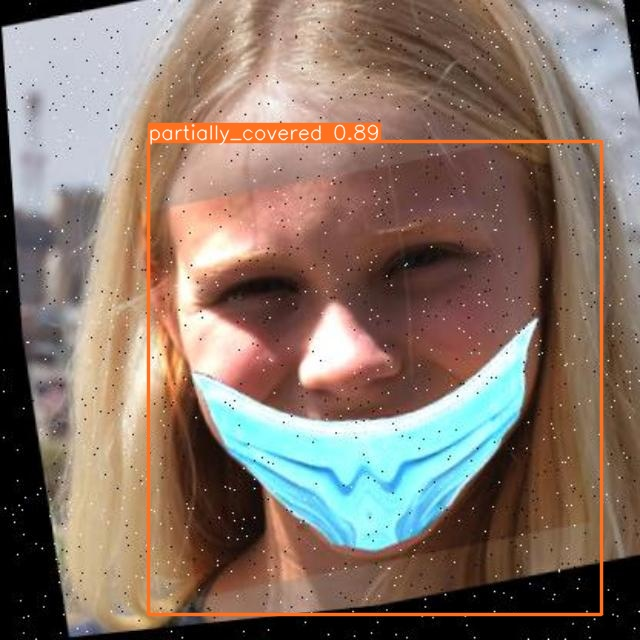

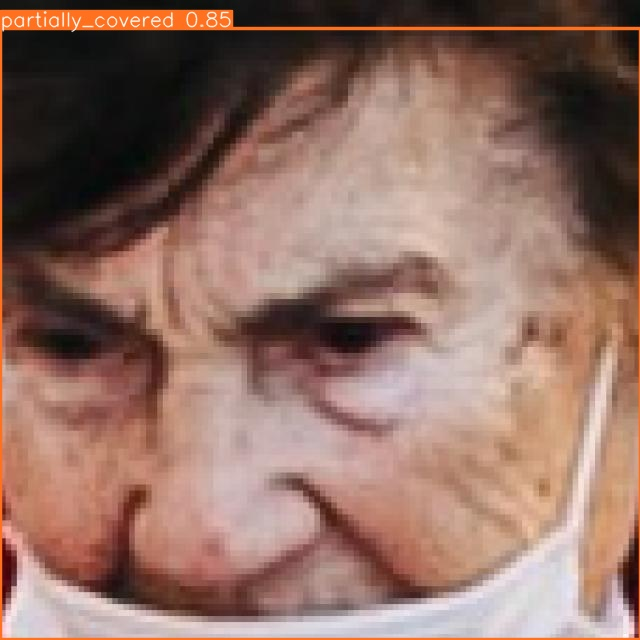

In [3]:
import glob
from IPython.display import display, Image

TEST_RES_PATH = "/notebooks/small/runs/detect/predict9"

for image_path in glob.glob(f'{TEST_RES_PATH}/*.jpg')[:3]:
    display(Image(filename=image_path, width=400))
    print('\n')

### Test the custom model to some other cases

In [8]:
!yolo task=detect mode=predict model={RES_PATH}/weights/best.pt conf=0.5 source="/notebooks/datasets/sometestcases" save=True

Ultralytics YOLOv8.0.113 🚀 Python-3.9.16 torch-1.12.1+cu116 CUDA:0 (NVIDIA RTX A4000, 16117MiB)
Model summary (fused): 168 layers, 11126745 parameters, 0 gradients

image 1/5 /notebooks/datasets/sometestcases/beard1.png: 288x640 3 uncovereds, 13.8ms
image 2/5 /notebooks/datasets/sometestcases/beard2.png: 288x640 3 uncovereds, 7.8ms
image 3/5 /notebooks/datasets/sometestcases/clear.png: 288x640 1 uncovered, 3 fully_covereds, 3 partially_covereds, 6.6ms
image 4/5 /notebooks/datasets/sometestcases/realist.png: 288x640 6 uncovereds, 1 partially_covered, 6.5ms
image 5/5 /notebooks/datasets/sometestcases/skintone.png: 288x640 3 fully_covereds, 7.5ms
Speed: 1.6ms preprocess, 8.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict14


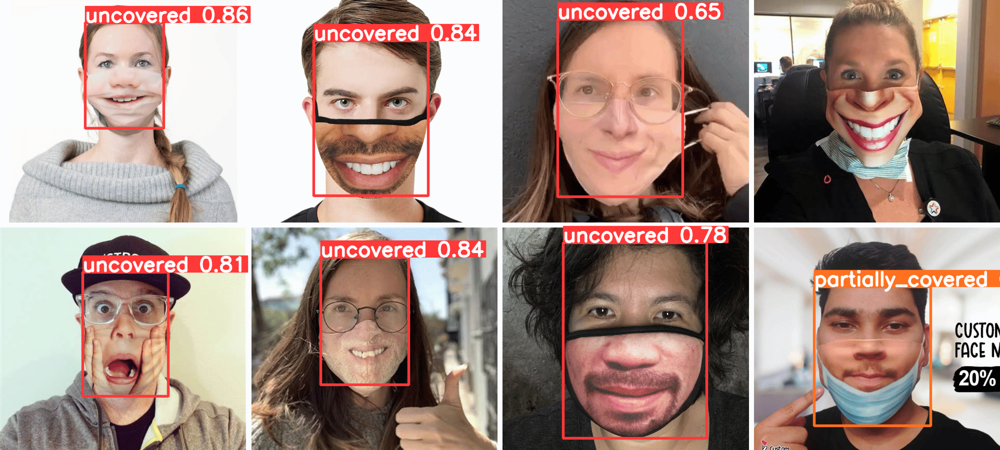

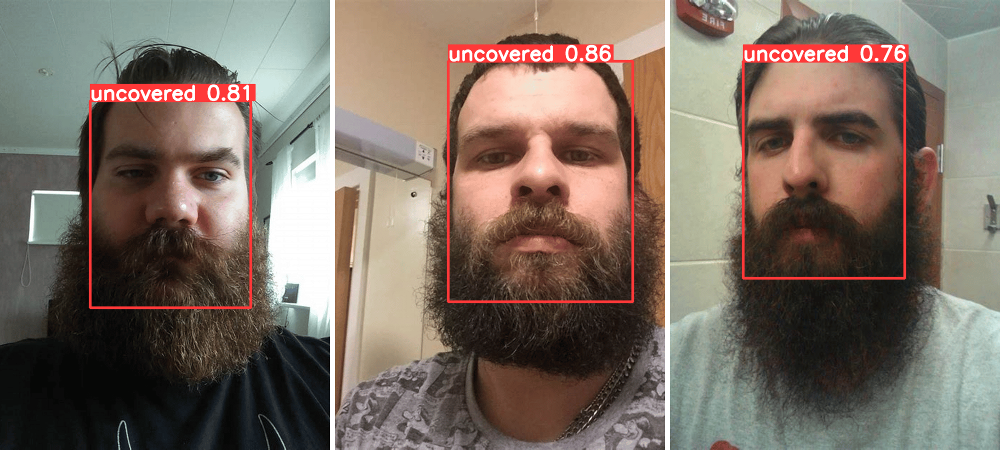

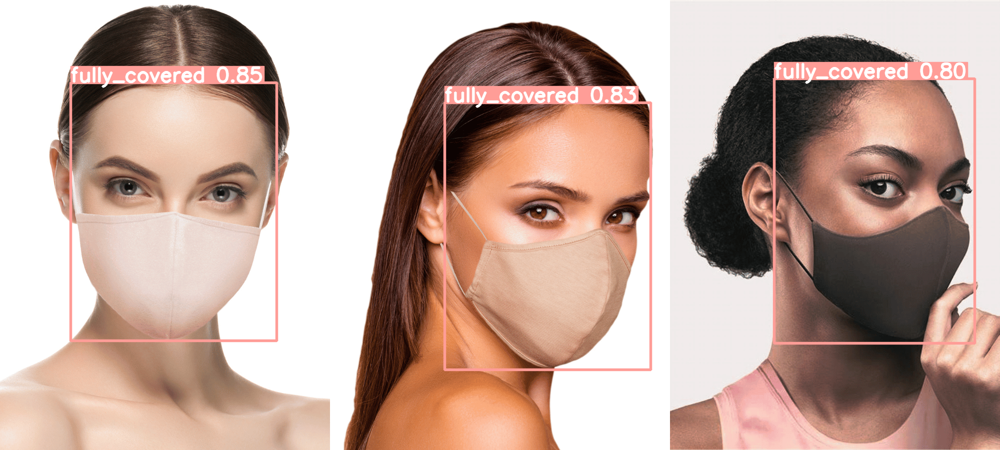

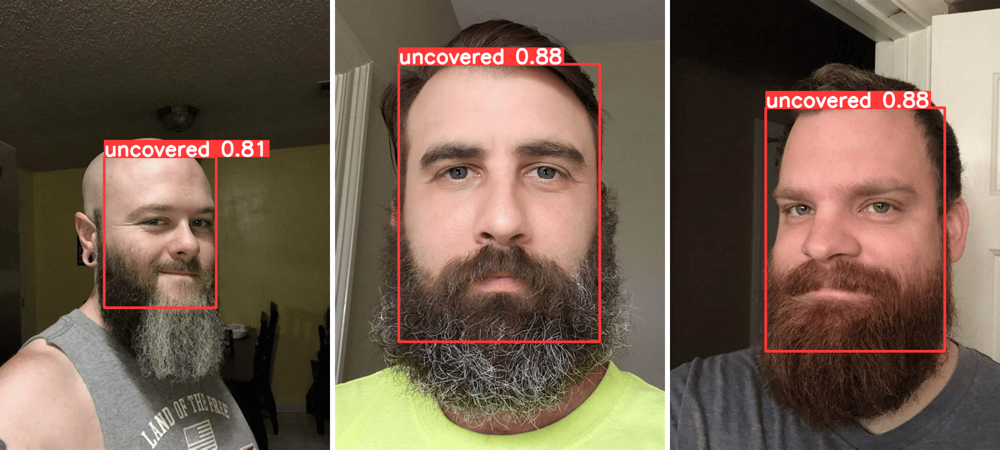

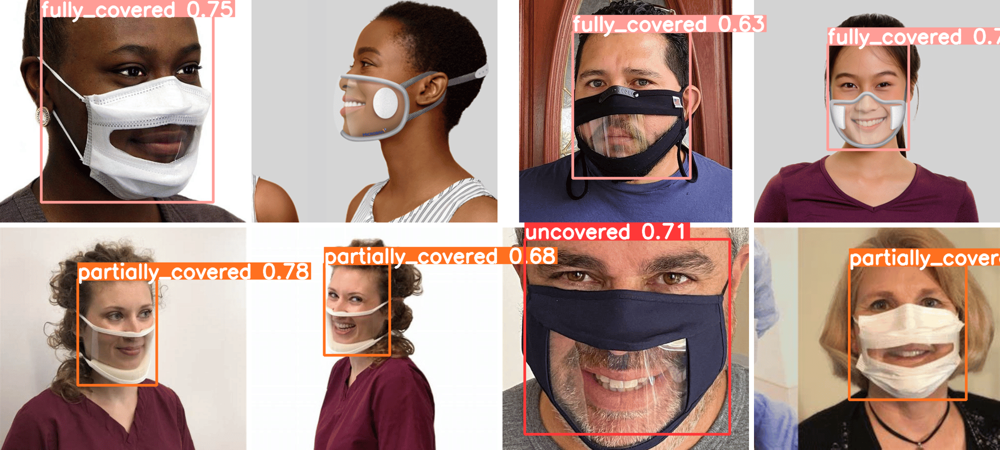

In [9]:
import glob
from IPython.display import display, Image

SOME_CASES = "/notebooks/small/runs/detect/predict14"

for image_path in glob.glob(f'{SOME_CASES}/*.*'):
    display(Image(filename=image_path, width=700))
    print('\n')

In [10]:
!zip -r test_cases_results.zip '/notebooks/small/runs/detect/predict14'

  adding: notebooks/small/runs/detect/predict14/ (stored 0%)
  adding: notebooks/small/runs/detect/predict14/realist.png (deflated 11%)
  adding: notebooks/small/runs/detect/predict14/beard1.png (deflated 8%)
  adding: notebooks/small/runs/detect/predict14/skintone.png (deflated 6%)
  adding: notebooks/small/runs/detect/predict14/beard2.png (deflated 8%)
  adding: notebooks/small/runs/detect/predict14/clear.png (deflated 8%)


In [3]:
!yolo task=detect mode=predict model={RES_PATH}/weights/best.pt conf=0.5 source="/notebooks/datasets/other_test_imgs/block_b.JPG" save=True

Ultralytics YOLOv8.0.113 🚀 Python-3.9.16 torch-1.12.1+cu116 CUDA:0 (NVIDIA RTX A4000, 16117MiB)
Model summary (fused): 168 layers, 11126745 parameters, 0 gradients

image 1/1 /notebooks/datasets/other_test_imgs/block_b.JPG: 576x640 1 uncovered, 16 fully_covereds, 12.9ms
Speed: 7.0ms preprocess, 12.9ms inference, 14.0ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict13


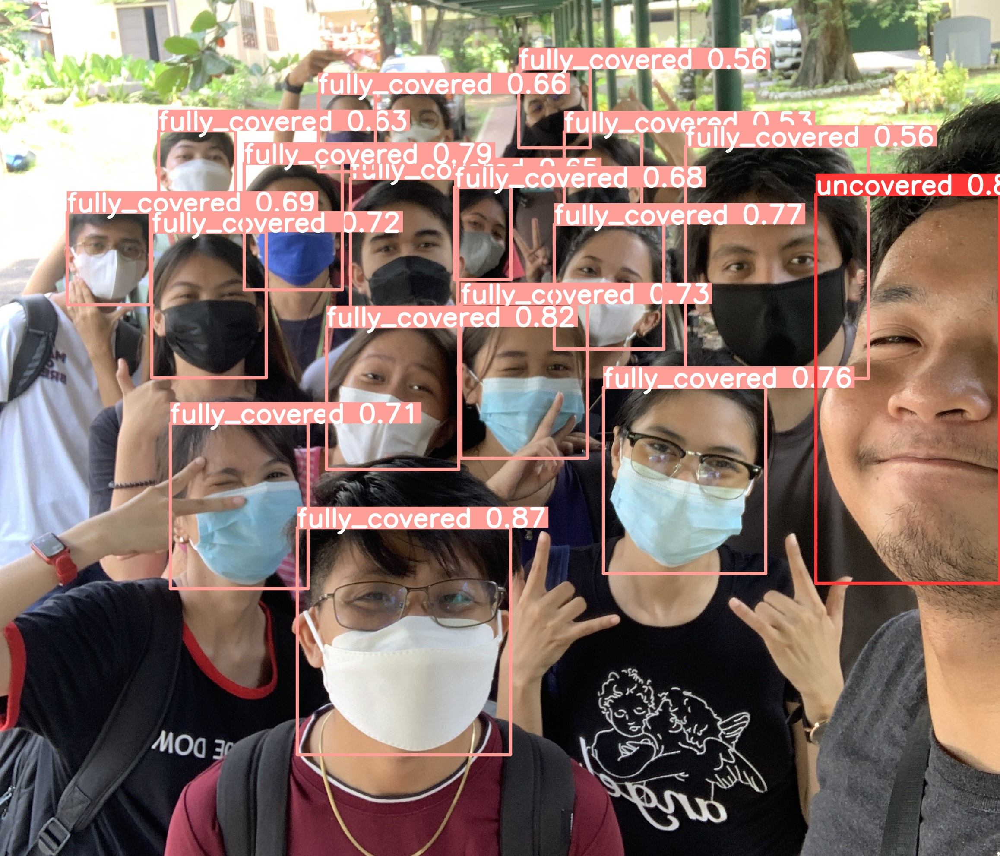

In [6]:
import glob
from IPython.display import display, Image

OTHER_CASES = "/notebooks/small/runs/detect/predict13"

for image_path in glob.glob(f'{OTHER_CASES}/*.*'):
    display(Image(filename=image_path, width=700))
    print('\n')

------

## 5. Get inference speeds

In [1]:
source = "/notebooks/maskon_dataset/test"

### 5.1 Warm-up the model

In [4]:
import torch
model.predict(torch.zeros(16,3,320,640))


2286.0ms


[ultralytics.yolo.engine.results.Results object with attributes:
 
 boxes: ultralytics.yolo.engine.results.Boxes object
 keypoints: None
 keys: ['boxes']
 masks: None
 names: {0: 'uncovered', 1: 'fully_covered', 2: 'partially_covered'}
 orig_img: tensor([[[[0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           ...,
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.]],
 
          [[0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           ...,
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.]],
 
          [[0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           ...,
           [0., 0., 0.,  ..., 0., 0., 0.],
           [

### 5.2 Get model's inference speed on GPU

* Machine: NVIDIA RTX A4000 | 45GB RAM 8CPU 16GPU

> Note: Both input and weight tensors must be running on GPU to run predictions correctly.

In [6]:
model.to("cuda:0")

In [7]:
# Test on GPU
results = model.predict(source, save=True, imgsz=640, conf=0.5)



    WARNING ⚠️ stream/video/webcam/dir predict source will accumulate results in RAM unless `stream=True` is passed,
    causing potential out-of-memory errors for large sources or long-running streams/videos.

    Usage:
        results = model(source=..., stream=True)  # generator of Results objects
        for r in results:
            boxes = r.boxes  # Boxes object for bbox outputs
            masks = r.masks  # Masks object for segment masks outputs
            probs = r.probs  # Class probabilities for classification outputs

image 1/3165 /notebooks/maskon_dataset/test/images/-1x-1_jpg.rf.a45473a343abb657cefa66adb8db92cf.jpg: 640x640 3 uncovereds, 9 fully_covereds, 7.5ms
image 2/3165 /notebooks/maskon_dataset/test/images/-I1-MS09uaqsLdGTFkgnS0Rcg1mmPyAj95ySg_eckoM_jpeg_jpg.rf.e689c0294bb6c6a98e565a4f7070d585.jpg: 640x640 2 fully_covereds, 6.7ms
image 3/3165 /notebooks/maskon_dataset/test/images/00003_Mask_Mouth_Chin_jpg.rf.48358e842329c6247a16b2de18a8ded9.jpg: 640x640 1 partia

* Speed: 1.6ms preprocess, 6.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
* FPS = 1000 / (1.6 + 7.0 + 1.1) = 1000 / 9.7 = 103.09 frames per second

### 5.3 Get model's inference speed on CPU

* Machine: 4 Cores

> Note: Both input and weight tensors must be running on CPU to run predictions correctly.

In [5]:
model.to("cpu")

In [6]:
# Test on CPU
results = model.predict(source, save=True, imgsz=640, conf=0.5, device="cpu")



    WARNING ⚠️ stream/video/webcam/dir predict source will accumulate results in RAM unless `stream=True` is passed,
    causing potential out-of-memory errors for large sources or long-running streams/videos.

    Usage:
        results = model(source=..., stream=True)  # generator of Results objects
        for r in results:
            boxes = r.boxes  # Boxes object for bbox outputs
            masks = r.masks  # Masks object for segment masks outputs
            probs = r.probs  # Class probabilities for classification outputs

image 1/3165 /notebooks/maskon_dataset/test/images/-1x-1_jpg.rf.a45473a343abb657cefa66adb8db92cf.jpg: 640x640 3 uncovereds, 9 fully_covereds, 209.5ms
image 2/3165 /notebooks/maskon_dataset/test/images/-I1-MS09uaqsLdGTFkgnS0Rcg1mmPyAj95ySg_eckoM_jpeg_jpg.rf.e689c0294bb6c6a98e565a4f7070d585.jpg: 640x640 2 fully_covereds, 689.7ms
image 3/3165 /notebooks/maskon_dataset/test/images/00003_Mask_Mouth_Chin_jpg.rf.48358e842329c6247a16b2de18a8ded9.jpg: 640x640 1 pa

* Speed: 3.0ms preprocess, 355.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
* FPS = 1000 / (3.0 + 355.9 + 1.4) = 2.77 frames per second

------

## 6. Convert model to TensorFlow JS

In [3]:
!yolo export model="/notebooks/small/runs/detect/train3/weights/best.pt" format=tfjs imgsz=640

Ultralytics YOLOv8.0.114 🚀 Python-3.9.16 torch-1.12.1+cu116 CPU
Model summary (fused): 168 layers, 11126745 parameters, 0 gradients

PyTorch: starting from /notebooks/small/runs/detect/train3/weights/best.pt with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 7, 8400) (21.5 MB)

TensorFlow SavedModel: starting export with tensorflow 2.12.0...

ONNX: starting export with onnx 1.14.0 opset 10...
ONNX: simplifying with onnxsim 0.4.31...
ONNX: export success ✅ 2.7s, saved as /notebooks/small/runs/detect/train3/weights/best.onnx (42.6 MB)

TensorFlow SavedModel: running 'onnx2tf -i /notebooks/small/runs/detect/train3/weights/best.onnx -o /notebooks/small/runs/detect/train3/weights/best_saved_model -nuo --non_verbose'
2023-06-06 14:04:34.694086: E tensorflow/compiler/xla/stream_executor/cuda/cuda_driver.cc:266] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
TensorFlow SavedModel: export success ✅ 15.8s, saved as /notebooks/small/runs/detect/train3/

----

## 7. Zip the models to download locally

In [ ]:
!zip -r maskon_small.zip '/notebooks/small/runs/detect/train3/weights'

  adding: notebooks/small/runs/detect/train3/weights/ (stored 0%)
  adding: notebooks/small/runs/detect/train3/weights/best.pt (deflated 8%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/ (stored 0%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/model.json (deflated 94%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/group1-shard10of11.bin (deflated 7%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/group1-shard11of11.bin (deflated 7%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/group1-shard6of11.bin (deflated 7%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/group1-shard7of11.bin (deflated 7%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/group1-shard4of11.bin (deflated 7%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/group1-shard1of11.bin (deflated 11%)
  adding: notebooks/small/runs/detect/train3/weights/best

In [10]:
!zip -r tflite_web_model.zip '/notebooks/small/runs/detect/train3/weights/best_web_model'

  adding: notebooks/small/runs/detect/train3/weights/best_web_model/ (stored 0%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/model.json (deflated 94%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/group1-shard10of11.bin (deflated 7%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/group1-shard11of11.bin (deflated 7%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/group1-shard6of11.bin (deflated 7%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/group1-shard7of11.bin (deflated 7%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/group1-shard4of11.bin (deflated 7%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/group1-shard1of11.bin (deflated 11%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/group1-shard8of11.bin (deflated 7%)
  adding: notebooks/small/runs/detect/train3/weights/best_web_model/group1-shard9of11.bin (def